In [1]:
import numpy as np
import pandas as pd 
from sklearn.model_selection import train_test_split
import torch
import matplotlib.pyplot as plt
import torch.nn as nn
import torch.optim as optim

In [18]:
train = pd.read_csv('./train.csv')
test = pd.read_csv('./test.csv')

## 数据探索

In [21]:
intCol = 0
objCol = 0
for col in train.columns:
    if train[col].dtype == 'float64' or train[col].dtype == 'int64':  # 识别数值列
        intCol += 1
    elif train[col].dtype == 'object':  # 识别分类列
        objCol+=1
intCol,objCol

(38, 43)

In [35]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

<Axes: >

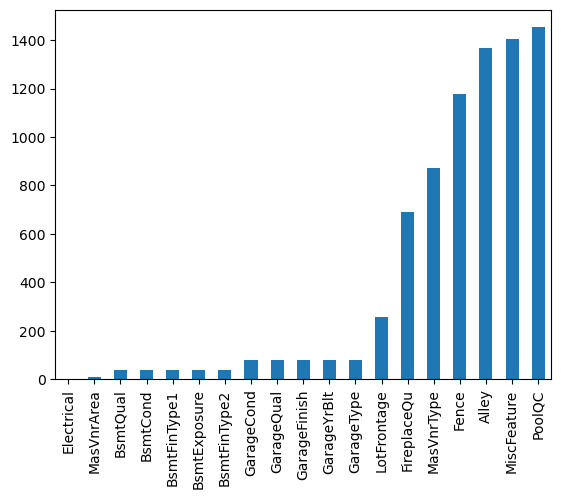

In [36]:
missing = train.isnull().sum()
missing = missing[missing > 0]
missing.sort_values(inplace=True)
missing.plot.bar()

<Axes: >

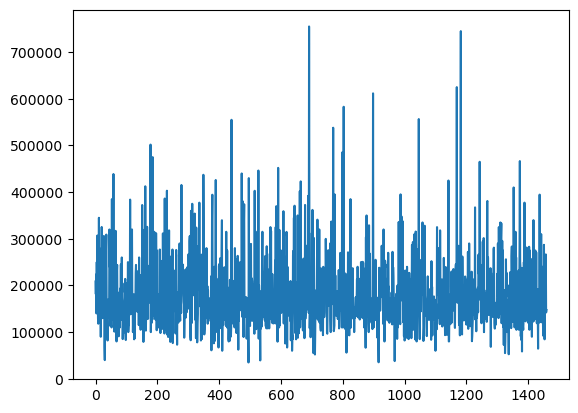

In [37]:
train["SalePrice"].plot.line()

In [38]:
train_cleaned = train.dropna(axis=1, thresh=len(train) - 200)


In [39]:
train_cleaned_encoded = pd.get_dummies(train_cleaned, drop_first=True)
train_cleaned_encoded

,Id,MSSubClass,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,1,60,8450,7,5,2003,2003,196.0,706,0,...,False,False,False,False,True,False,False,False,True,False
1,2,20,9600,6,8,1976,1976,0.0,978,0,...,False,False,False,False,True,False,False,False,True,False
2,3,60,11250,7,5,2001,2002,162.0,486,0,...,False,False,False,False,True,False,False,False,True,False
3,4,70,9550,7,5,1915,1970,0.0,216,0,...,False,False,False,False,True,False,False,False,False,False
4,5,60,14260,8,5,2000,2000,350.0,655,0,...,False,False,False,False,True,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,7917,6,5,1999,2000,0.0,0,0,...,False,False,False,False,True,False,False,False,True,False
1456,1457,20,13175,6,6,1978,1988,119.0,790,163,...,False,False,False,False,True,False,False,False,True,False
1457,1458,70,9042,7,9,1941,2006,0.0,275,0,...,False,False,False,False,True,False,False,False,True,False
1458,1459,20,9717,5,6,1950,1996,0.0,49,1029,...,False,False,False,False,True,False,False,False,True,False


In [40]:
train_cleaned_encoded.drop(["Id"],axis = 1, inplace= True)
# 计算特征与目标特征的相关性矩阵
correlation_matrix = train_cleaned_encoded.corr()

# 查看目标特征与其他特征的相关性
target_correlation = correlation_matrix['SalePrice']
target_correlation

MSSubClass              -0.084284
LotArea                  0.263843
OverallQual              0.790982
OverallCond             -0.077856
YearBuilt                0.522897
                           ...   
SaleCondition_AdjLand   -0.050686
SaleCondition_Alloca    -0.015525
SaleCondition_Family    -0.046480
SaleCondition_Normal    -0.153990
SaleCondition_Partial    0.352060
Name: SalePrice, Length: 229, dtype: float64

In [41]:
filtered_correlations = target_correlation[abs(target_correlation) >= 0.1]

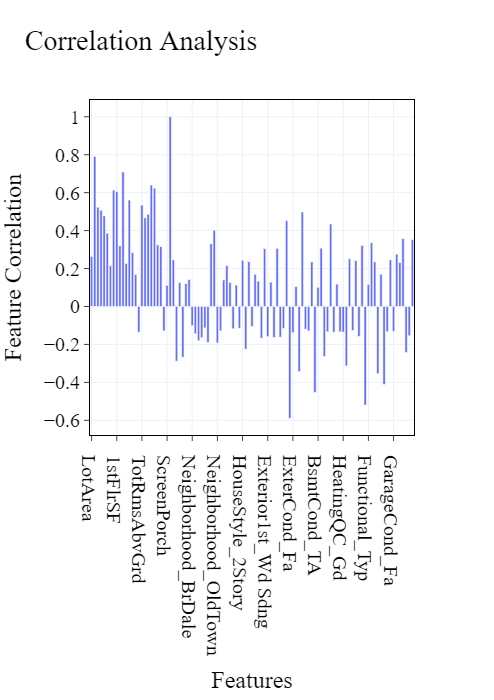

In [42]:
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as pyo
# # Set notebook mode to work in offline
pyo.init_notebook_mode()
# pio.renderers.default = 'iframe'

title = 'Correlation Analysis'
xaxis_title = 'Features'
yaxis_title = 'Feature Correlation'
font_size = 20
width = 1000
height = 700

fig = go.Figure(layout={"template": "plotly_white"})

fig.add_trace(go.Bar(x=filtered_correlations.index,y=filtered_correlations.values))


fig.update_yaxes(rangemode="tozero")

fig.update_layout(
    ######################## 图例设置 #############################
    title=title,
    width=width,
    height=height,
    legend=dict(x=1, y=1,  # 设置图例的位置，[0,1]之间
                font=dict(family='Times New Roman', size=15, color='black'),  # 设置图例的字体及颜色
                bordercolor="Black",
                borderwidth=0.5),
    xaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              linewidth=1, linecolor='black',
              ),
    yaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              tick0=0,
              linecolor='black'),
    xaxis_title=xaxis_title,  # X轴标题文本
    yaxis_title=yaxis_title,  # Y轴标题文本
    #     legend_title="Legend Title",      # 图例标题文本
    font=dict(
        family="Times New Roman",  # 所有标题文字的字体
        size=font_size,  # 所有标题文字的大小
        color="black"  # 所有标题的颜色
    ),
    xaxis_title_font_family='Times New Roman',  # 额外设置x轴标题的字体
    yaxis_title_font_color='black',  # 额外将y轴的字体设置为红色
)
# fig.write_html("./Correlation.html")
fig.show()


## 数据预处理

In [34]:
# 去除几乎全是空值的特征
train_cleaned = train.dropna(axis=1, thresh=len(train) - 200)
# 空值填充
for col in train_cleaned.columns:
    if train_cleaned[col].dtype == 'float64':  # 识别数值列
        train_cleaned[col] = train_cleaned[col].fillna(train_cleaned[col].mean())
    elif train_cleaned[col].dtype == 'object':  # 识别分类列
        most_common = train_cleaned[col].value_counts().idxmax()
        train_cleaned[col] = train_cleaned[col].fillna(most_common)
# 测试集空值填充
test_cleaned = test
for col in test_cleaned.columns:
    if test_cleaned[col].dtype == 'float64':  # 识别数值列
        test_cleaned[col] = test_cleaned[col].fillna(test_cleaned[col].mean())
    elif test_cleaned[col].dtype == 'object':  # 识别分类列
        most_common = test_cleaned[col].value_counts().idxmax()
        test_cleaned[col] = test_cleaned[col].fillna(most_common)   
        
# 删除数据集上下两端10%的数据以去除离群值
q_low = train_cleaned['SalePrice'].quantile(0.1)
q_high = train_cleaned['SalePrice'].quantile(0.9)
# 保留'SalePrice'在这两个分位数之间的行
train_cleaned = train_cleaned[(train_cleaned['SalePrice'] > q_low) & (train_cleaned['SalePrice'] < q_high)]        
        

In [35]:
# 将非连续变量编码
from sklearn.preprocessing import LabelEncoder

# 标记训练集和测试集
train_cleaned['is_train'] = 1
test_cleaned['is_train'] = 0

# 合并数据集
combined_df = pd.concat([train_cleaned, test_cleaned])

# 将训练集的编码器保存在一个字典中
encoders = {}

for column in combined_df.columns:
    if combined_df[column].dtype == 'object':  # 假设所有的object类型都需要编码
        le = LabelEncoder()
        combined_df[column] = le.fit_transform(combined_df[column])
        encoders[column] = le

# 分离训练集和测试集
train_cleaned = combined_df[combined_df['is_train'] == 1].drop('is_train', axis=1)
test_cleaned = combined_df[combined_df['is_train'] == 0].drop('is_train', axis=1)

In [36]:
# 将布尔值映射为0和1
# train_cleaned_encoded = train_cleaned.applymap(lambda x: int(x) if isinstance(x, bool) else x)
# test_cleaned_encoded = test_cleaned.applymap(lambda x: int(x) if isinstance(x, bool) else x)

# 查看目标特征与其他特征的相关性
correlation_matrix = train_cleaned.corr()
target_correlation = correlation_matrix['SalePrice']
# 找出相关性小于0.1的特征
# low_corr_features = target_correlation[abs(target_correlation) < 0.1].index
# 删除这些特征
# train_cleaned_encoded.drop(columns=low_corr_features, inplace=True)

# 按照相关性的绝对值排序并选择前2个特征
top_10_features = target_correlation.abs().sort_values(ascending=False).head(3)
train_cleaned_encoded = train_cleaned[top_10_features.index]
# 测试集也选择同样特征
test_cleaned = test_cleaned[top_10_features.index]
test_cleaned.drop(["SalePrice"],axis=1,inplace=True)
# 分割数据集
X,y = train_cleaned_encoded.drop(["SalePrice"],axis=1), train_cleaned_encoded["SalePrice"]
train_X,valid_X,train_y,valid_y = train_test_split(X, y, test_size=0.1, random_state=42)

# 特征缩放
from sklearn.preprocessing import MinMaxScaler
# 初始化 MinMaxScaler
scaler = MinMaxScaler(feature_range=(0, 1))

train_scaler = scaler.fit(train_X)
# 拟合并转换数据
train_X = train_scaler.transform(train_X)
valid_X = train_scaler.transform(valid_X)
test_X = train_scaler.transform(test_cleaned)
# 将缩放后的数据转换回数据帧
# scaled_df = pd.DataFrame(scaled_data, columns=df.columns)


# 将数据集转化为tensor用于训练
train_X = torch.tensor(train_X, dtype=torch.float32)
train_y = torch.tensor(train_y.values, dtype=torch.float32)
valid_X = torch.tensor(valid_X, dtype=torch.float32)
valid_y = torch.tensor(valid_y.values, dtype=torch.float32)

test_X = torch.tensor(test_X, dtype=torch.float32)

print(f'train shape is {train_X.shape}')

train shape is torch.Size([1050, 2])


## 神经网络构建

In [37]:
torch.manual_seed(0) # 结果可复现

class SimpleNN(nn.Module):
    def __init__(self):
        super(SimpleNN, self).__init__()
        self.fn1 = nn.Linear(train_X.shape[1], 128)
        self.actvation1 = nn.ReLU()
        self.dropout1 = nn.Dropout(0.1)  # 30% dropout

        self.fn2 = nn.Linear(128, 64)
        self.actvation2 = nn.ReLU()
        self.dropout2 = nn.Dropout(0.1)
        
        self.fn3 = nn.Linear(64, 32)
        self.actvation3 = nn.ReLU()
        self.dropout3 = nn.Dropout(0.1)

        self.fn4 = nn.Linear(32, 16)
        self.actvation4 = nn.ReLU()
        self.dropout4 = nn.Dropout(0.1)
        
        self.fn5 = nn.Linear(16, 8)
        self.actvation5 = nn.ReLU()
        self.dropout5 = nn.Dropout(0.1)
        
        self.fn6 = nn.Linear(8, 1)


    def forward(self, x):
        x1 = self.dropout1(self.actvation1(self.fn1(x)))
        x2 = self.dropout2(self.actvation2(self.fn2(x1)))
        x3 = self.dropout3(self.actvation3(self.fn3(x2)))
        x4 = self.dropout4(self.actvation4(self.fn4(x3)))
        x5 = self.dropout5(self.actvation5(self.fn5(x4)))

        x6 = self.fn6(x5)
        
        return x6


In [46]:
# 手动实现Adam
class SimpleAdam:
    def __init__(self, params, lr=0.001, betas=(0.9, 0.999), eps=1e-8):
        self.params = list(params) # params：这是一个模型参数的迭代器。通常，这将是 model.parameters()，即模型所有可训练参数的列表。
        self.lr = lr
        self.betas = betas # 这是两个用于计算梯度和梯度平方的运行平均的超参数
        self.eps = eps # 为了防止除以零，这是一个非常小的数值，加在分母上
        self.t = 0 # 计数器，用于记录优化器迭代的次数
        # 存储每个参数的一阶和二阶矩估计的列表
        self.m = [torch.zeros_like(p.data) for p in self.params]
        self.v = [torch.zeros_like(p.data) for p in self.params]

    def step(self):
        self.t += 1
        for p, m, v in zip(self.params, self.m, self.v): # 对于每个参数 p 及其对应的一阶和二阶矩 m 和 v
            if p.grad is None:
                continue

            grad = p.grad.data # 取得当前参数的梯度

            # 更新一阶和二阶矩估计(带_是原位计算)
            m.mul_(self.betas[0]).add_(grad, alpha=1 - self.betas[0])
            v.mul_(self.betas[1]).addcmul_(grad, grad, value=1 - self.betas[1])

            # 计算偏差校正的一阶和二阶矩估计
            m_hat = m / (1 - self.betas[0] ** self.t)
            v_hat = v / (1 - self.betas[1] ** self.t)

            # 更新参数 对张量 1 按元素除以张量 2，将结果乘以标量值并将其添加到输入。
            p.data.addcdiv_(m_hat, v_hat.sqrt().add_(self.eps), value=-self.lr) 
            
# 手动实现损失函数 MAE
class MAELoss(nn.Module):
    def __init__(self):
        super(MAELoss, self).__init__()

    def forward(self, input, target):
        return torch.mean(torch.abs(input - target))

In [50]:
model = SimpleNN()
# 损失函数
# criterion = nn.L1Loss()
criterion = MAELoss()
# def criterion(x,y):
#     eps = 1e-6
#     return torch.sqrt(nn.MSELoss(x, y) + eps)

# 优化器
optimizer = optim.Adam(model.parameters(),lr=0.005)
# optimizer = SimpleAdam(model.parameters(),lr=0.005)

In [51]:
# 训练模型
train_loss = []
valid_loss = []

epochs = 800
for epoch in range(epochs):
    # 前向传播
    outputs = model(train_X)
    loss = criterion(outputs, train_y)

    # 反向传播和优化
    # optimizer.zero_grad()
    model.zero_grad()
    
    loss.backward()
    optimizer.step()
    
    
    if (epoch+1) % 10 == 0:
        
        print(f'Epoch [{epoch+1}/{epochs}], train Loss: {loss.item():.4f}')
        print(f'Epoch [{epoch+1}/{epochs}], valid Loss: {v_loss.item():.4f}')

    # 计算验证集误差
    train_loss.append(loss.item())
    v_loss = criterion(model(valid_X), valid_y)
    valid_loss.append(v_loss.item())
        

Epoch [10/800], train Loss: 171045.1562
Epoch [10/800], valid Loss: 167501.1719
Epoch [20/800], train Loss: 171024.1406
Epoch [20/800], valid Loss: 167479.3750
Epoch [30/800], train Loss: 170858.2031
Epoch [30/800], valid Loss: 167317.6250
Epoch [40/800], train Loss: 169886.1719
Epoch [40/800], valid Loss: 166371.0156
Epoch [50/800], train Loss: 165438.7031
Epoch [50/800], valid Loss: 162046.7344
Epoch [60/800], train Loss: 148589.3906
Epoch [60/800], valid Loss: 145142.1875
Epoch [70/800], train Loss: 94470.5547
Epoch [70/800], valid Loss: 91837.8672
Epoch [80/800], train Loss: 55581.0039
Epoch [80/800], valid Loss: 61411.9805
Epoch [90/800], train Loss: 46019.3359
Epoch [90/800], valid Loss: 46624.9922
Epoch [100/800], train Loss: 47557.9023
Epoch [100/800], valid Loss: 46679.6484
Epoch [110/800], train Loss: 46346.1953
Epoch [110/800], valid Loss: 50382.9844
Epoch [120/800], train Loss: 45913.5195
Epoch [120/800], valid Loss: 48338.3398
Epoch [130/800], train Loss: 45213.6641
Epoch 

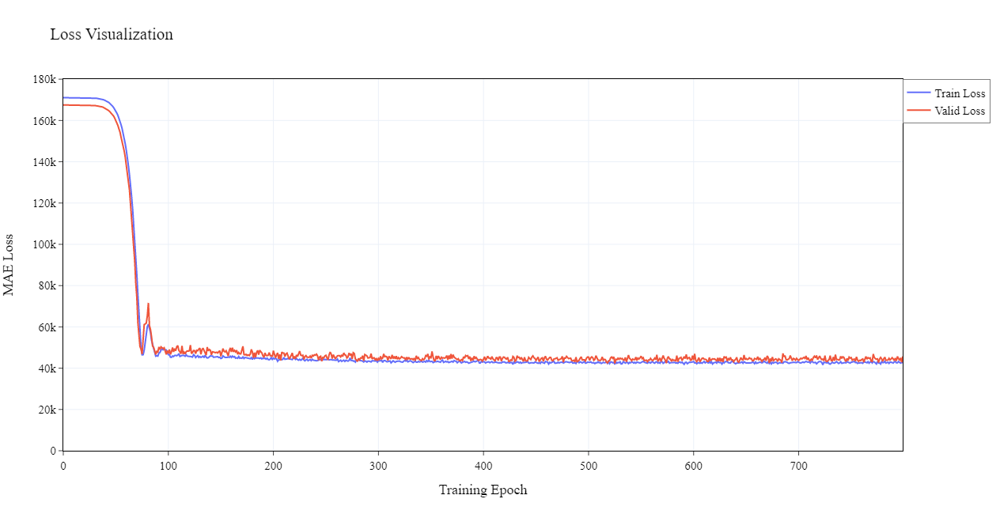

In [52]:
# 误差可视化
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as pyo
# # Set notebook mode to work in offline
pyo.init_notebook_mode()
# pio.renderers.default = 'iframe'

title = 'Loss Visualization'
xaxis_title = 'Training Epoch'
yaxis_title = 'MAE Loss'
font_size = 15
width = 900
height = 650

fig = go.Figure(layout={"template": "plotly_white"})

fig.add_trace(go.Scatter(x=[i for i in range(len(train_loss))],y=train_loss,name="Train Loss"))
fig.add_trace(go.Scatter(x=[i for i in range(len(train_loss))],y=valid_loss,name="Valid Loss"))


fig.update_yaxes(rangemode="tozero")

fig.update_layout(
    ######################## 图例设置 #############################
    title=title,
    width=width,
    height=height,
    legend=dict(x=1, y=1,  # 设置图例的位置，[0,1]之间
                font=dict(family='Times New Roman', size=15, color='black'),  # 设置图例的字体及颜色
                bordercolor="Black",
                borderwidth=0.5),
    xaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              linewidth=1, linecolor='black',
              ),
    yaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              tick0=0,
              linecolor='black'),
    xaxis_title=xaxis_title,  # X轴标题文本
    yaxis_title=yaxis_title,  # Y轴标题文本
    #     legend_title="Legend Title",      # 图例标题文本
    font=dict(
        family="Times New Roman",  # 所有标题文字的字体
        size=font_size,  # 所有标题文字的大小
        color="black"  # 所有标题的颜色
    ),
    xaxis_title_font_family='Times New Roman',  # 额外设置x轴标题的字体
    yaxis_title_font_color='black',  # 额外将y轴的字体设置为红色
)
fig.show()


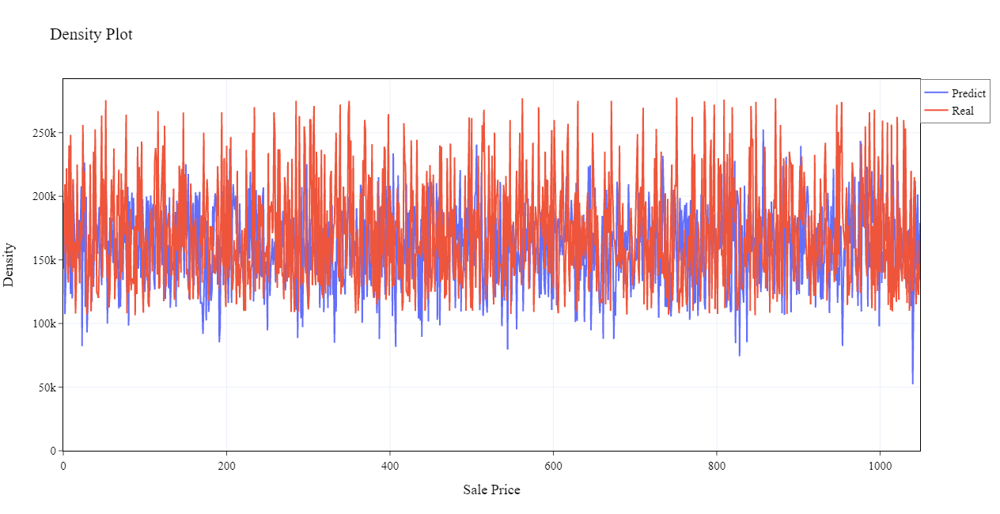

In [42]:
# 训练集表现

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as pyo
# # Set notebook mode to work in offline
pyo.init_notebook_mode()
# pio.renderers.default = 'iframe'

title = 'Density Plot'
xaxis_title = 'Sale Price'
yaxis_title = 'Density'
font_size = 15
width = 900
height = 650

fig = go.Figure(layout={"template": "plotly_white"})

model_predict = model(train_X).detach().numpy()
model_predict = np.squeeze(model_predict)

real_value = train_y.detach().numpy().tolist()


# 获取排序后的索引
# sorted_indices = sorted(range(len(real_value)), key=lambda i: real_value[i])
# # 使用索引重新排列list2
# model_predict = [model_predict[i] for i in sorted_indices]
# # 对list1也进行排序
# real_value = sorted(real_value)

fig.add_trace(go.Scatter(x=[i for i in range(len(model_predict))],y=model_predict,name="Predict"))
fig.add_trace(go.Scatter(x=[i for i in range(len(real_value))],y=real_value,name="Real"))

# Add title
fig.update_yaxes(rangemode="tozero")
fig.update_layout(
    ######################## 图例设置 #############################
    title=title,
    width=width,
    height=height,
    legend=dict(x=1, y=1,  # 设置图例的位置，[0,1]之间
                font=dict(family='Times New Roman', size=15, color='black'),  # 设置图例的字体及颜色
                bordercolor="Black",
                borderwidth=0.5),
    xaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              linewidth=1, linecolor='black',
              ),
    yaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              tick0=0,
              linecolor='black'),
    xaxis_title=xaxis_title,  # X轴标题文本
    yaxis_title=yaxis_title,  # Y轴标题文本
    #     legend_title="Legend Title",      # 图例标题文本
    font=dict(
        family="Times New Roman",  # 所有标题文字的字体
        size=font_size,  # 所有标题文字的大小
        color="black"  # 所有标题的颜色
    ),
    xaxis_title_font_family='Times New Roman',  # 额外设置x轴标题的字体
    yaxis_title_font_color='black',  # 额外将y轴的字体设置为红色
)

fig.show()

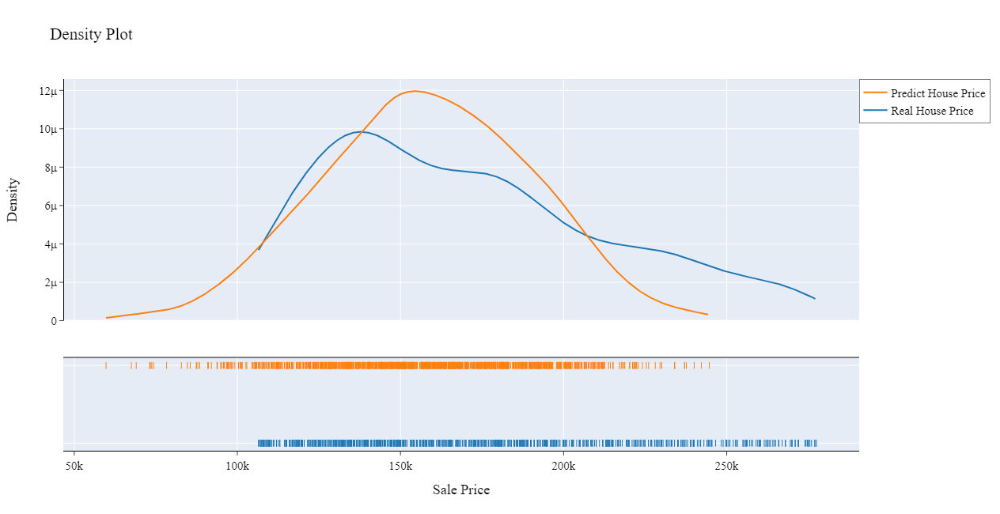

In [43]:

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as pyo
# # Set notebook mode to work in offline
pyo.init_notebook_mode()
# pio.renderers.default = 'iframe'

title = 'Density Plot'
xaxis_title = 'Sale Price'
yaxis_title = 'Density'
font_size = 15
width = 900
height = 650

fig = go.Figure(layout={"template": "plotly_white"})

model_predict = model(train_X).detach().numpy()
model_predict = np.squeeze(model_predict)

hist_data = [train_y.detach().numpy().tolist(), model_predict]

group_labels = ['Real House Price', 'Predict House Price']

# Create distplot with curve_type set to 'normal'
fig = ff.create_distplot(hist_data, group_labels, show_hist=False)

# Add title
fig.update_yaxes(rangemode="tozero")

fig.update_layout(
    ######################## 图例设置 #############################
    title=title,
    width=width,
    height=height,
    legend=dict(x=1, y=1,  # 设置图例的位置，[0,1]之间
                font=dict(family='Times New Roman', size=15, color='black'),  # 设置图例的字体及颜色
                bordercolor="Black",
                borderwidth=0.5),
    xaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              linewidth=1, linecolor='black',
              ),
    yaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              tick0=0,
              linecolor='black'),
    xaxis_title=xaxis_title,  # X轴标题文本
    yaxis_title=yaxis_title,  # Y轴标题文本
    #     legend_title="Legend Title",      # 图例标题文本
    font=dict(
        family="Times New Roman",  # 所有标题文字的字体
        size=font_size,  # 所有标题文字的大小
        color="black"  # 所有标题的颜色
    ),
    xaxis_title_font_family='Times New Roman',  # 额外设置x轴标题的字体
    yaxis_title_font_color='black',  # 额外将y轴的字体设置为红色
)


fig.show()

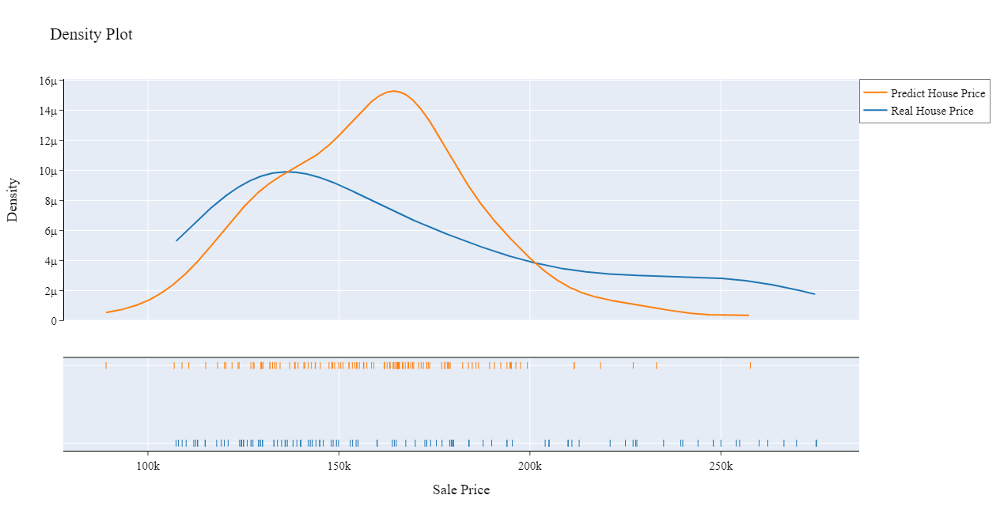

In [53]:
# 验证集表现

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as pyo
# # Set notebook mode to work in offline
pyo.init_notebook_mode()
# pio.renderers.default = 'iframe'

title = 'Density Plot'
xaxis_title = 'Sale Price'
yaxis_title = 'Density'
font_size = 15
width = 900
height = 650

fig = go.Figure(layout={"template": "plotly_white"})

model_predict = model(valid_X).detach().numpy()
model_predict = np.squeeze(model_predict)

hist_data = [valid_y.detach().numpy().tolist(), model_predict]

group_labels = ['Real House Price', 'Predict House Price']

# Create distplot with curve_type set to 'normal'
fig = ff.create_distplot(hist_data, group_labels, show_hist=False)

# Add title
fig.update_yaxes(rangemode="tozero")

fig.update_layout(
    ######################## 图例设置 #############################
    title=title,
    width=width,
    height=height,
    legend=dict(x=1, y=1,  # 设置图例的位置，[0,1]之间
                font=dict(family='Times New Roman', size=15, color='black'),  # 设置图例的字体及颜色
                bordercolor="Black",
                borderwidth=0.5),
    xaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              linewidth=1, linecolor='black',
              ),
    yaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              tick0=0,
              linecolor='black'),
    xaxis_title=xaxis_title,  # X轴标题文本
    yaxis_title=yaxis_title,  # Y轴标题文本
    #     legend_title="Legend Title",      # 图例标题文本
    font=dict(
        family="Times New Roman",  # 所有标题文字的字体
        size=font_size,  # 所有标题文字的大小
        color="black"  # 所有标题的颜色
    ),
    xaxis_title_font_family='Times New Roman',  # 额外设置x轴标题的字体
    yaxis_title_font_color='black',  # 额外将y轴的字体设置为红色
)


fig.show()

## 测试集数据预测

In [69]:
test_predict = model(test_X).detach().numpy()
test_predict = np.squeeze(test_predict)

In [70]:
# 查看基准差异
linear_sample = pd.read_csv('./sample_submission.csv')
linear_result = linear_sample['SalePrice']

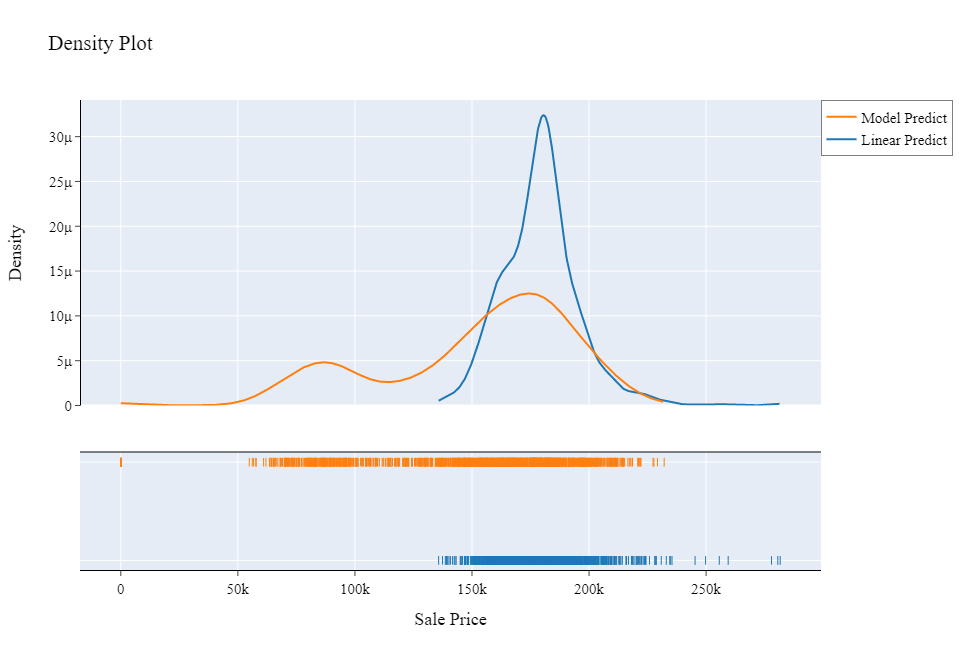

In [71]:
import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as pyo
# # Set notebook mode to work in offline
pyo.init_notebook_mode()
# pio.renderers.default = 'iframe'

title = 'Density Plot'
xaxis_title = 'Sale Price'
yaxis_title = 'Density'
font_size = 15
width = 900
height = 650

fig = go.Figure(layout={"template": "plotly_white"})

hist_data = [linear_result, test_predict]

group_labels = ['Linear Predict', 'Model Predict']

# Create distplot with curve_type set to 'normal'
fig = ff.create_distplot(hist_data, group_labels, show_hist=False)

# Add title
fig.update_yaxes(rangemode="tozero")

fig.update_layout(
    ######################## 图例设置 #############################
    title=title,
    width=width,
    height=height,
    legend=dict(x=1, y=1,  # 设置图例的位置，[0,1]之间
                font=dict(family='Times New Roman', size=15, color='black'),  # 设置图例的字体及颜色
                bordercolor="Black",
                borderwidth=0.5),
    xaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              linewidth=1, linecolor='black',
              ),
    yaxis=dict(mirror=True,
              ticks='outside',
              showline=True,
              showgrid=True,
              tick0=0,
              linecolor='black'),
    xaxis_title=xaxis_title,  # X轴标题文本
    yaxis_title=yaxis_title,  # Y轴标题文本
    #     legend_title="Legend Title",      # 图例标题文本
    font=dict(
        family="Times New Roman",  # 所有标题文字的字体
        size=font_size,  # 所有标题文字的大小
        color="black"  # 所有标题的颜色
    ),
    xaxis_title_font_family='Times New Roman',  # 额外设置x轴标题的字体
    yaxis_title_font_color='black',  # 额外将y轴的字体设置为红色
)


fig.show()

In [ ]:
# 制作提交数据并保存
linear_sample['SalePrice'] = test_predict
linear_sample.to_csv('predict_result.csv',index=False)